<a href="https://colab.research.google.com/github/nabil99-A/midproject/blob/main/nyc_collisions_midproject_epsilon.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [150]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from geopy.geocoders import Nominatim
import folium
from folium.plugins import MarkerCluster
import plotly.graph_objects as go
from plotly.subplots import make_subplots


In [151]:
!pip install --upgrade urllib3
!pip install holoviews geoviews colorcet
!pip install datashader
!pip install datasist
!pip install reverse_geocoder
!pip install mplcursors

In [152]:
!pip install mpldatacursor

In [153]:
df = pd.read_csv('/content/drive/MyDrive/Motor_Vehicle_Collisions_-_Crashes (1).csv')

<ipython-input-153-a7774a4b24d1>:1: DtypeWarning:

Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.



In [154]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2030510 entries, 0 to 2030509
Data columns (total 29 columns):
 #   Column                         Dtype  
---  ------                         -----  
 0   CRASH DATE                     object 
 1   CRASH TIME                     object 
 2   BOROUGH                        object 
 3   ZIP CODE                       object 
 4   LATITUDE                       float64
 5   LONGITUDE                      float64
 6   LOCATION                       object 
 7   ON STREET NAME                 object 
 8   CROSS STREET NAME              object 
 9   OFF STREET NAME                object 
 10  NUMBER OF PERSONS INJURED      float64
 11  NUMBER OF PERSONS KILLED       float64
 12  NUMBER OF PEDESTRIANS INJURED  int64  
 13  NUMBER OF PEDESTRIANS KILLED   int64  
 14  NUMBER OF CYCLIST INJURED      int64  
 15  NUMBER OF CYCLIST KILLED       int64  
 16  NUMBER OF MOTORIST INJURED     int64  
 17  NUMBER OF MOTORIST KILLED      int64  
 18  CO

In [155]:
df.isnull().sum()

CRASH DATE                             0
CRASH TIME                             0
BOROUGH                           631662
ZIP CODE                          631902
LATITUDE                          230595
LONGITUDE                         230595
LOCATION                          230595
ON STREET NAME                    428243
CROSS STREET NAME                 761782
OFF STREET NAME                  1694640
NUMBER OF PERSONS INJURED             18
NUMBER OF PERSONS KILLED              31
NUMBER OF PEDESTRIANS INJURED          0
NUMBER OF PEDESTRIANS KILLED           0
NUMBER OF CYCLIST INJURED              0
NUMBER OF CYCLIST KILLED               0
NUMBER OF MOTORIST INJURED             0
NUMBER OF MOTORIST KILLED              0
CONTRIBUTING FACTOR VEHICLE 1       6425
CONTRIBUTING FACTOR VEHICLE 2     310643
CONTRIBUTING FACTOR VEHICLE 3    1886267
CONTRIBUTING FACTOR VEHICLE 4    1998112
CONTRIBUTING FACTOR VEHICLE 5    2021749
COLLISION_ID                           0
VEHICLE TYPE COD

#DATE,TIME

In [156]:
#set date and time type to process
df['CRASH DATE'] = df['CRASH DATE'].astype(str)
df['CRASH TIME'] = df['CRASH TIME'].astype(str)

# Concatenate 'CRASH DATE' and 'CRASH TIME' columns with a space separator
df['CRASH DATETIME'] = df['CRASH DATE'] + ' ' + df['CRASH TIME']

df['CRASH DATETIME'] = pd.to_datetime(df['CRASH DATETIME'])

df.drop(['CRASH DATE','CRASH TIME'] ,axis = 1, inplace = True)

In [157]:
#task mission on 2018 to 2023
df = df.loc[~df['CRASH DATETIME'].dt.year.between(2012, 2017)]

#VEHICLE TYPES(EFFECTED)

In [158]:
#convert affected vehicle types(type2,3,4,5) columns to integers to count in one column(sub vehicles)

In [159]:
df['VEHICLE TYPE CODE 2'][~df['VEHICLE TYPE CODE 2'].isna()] = 1

<ipython-input-159-1f24a7c01252>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [160]:
df['VEHICLE TYPE CODE 2'][df['VEHICLE TYPE CODE 2'].isna()] = 0

<ipython-input-160-cf8a44f8fa9e>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [161]:
#test code
df['VEHICLE TYPE CODE 2'].unique()

array([1, 0], dtype=object)

In [162]:
df['VEHICLE TYPE CODE 3'][~df['VEHICLE TYPE CODE 3'].isna()] = 1

In [163]:
df['VEHICLE TYPE CODE 3'][df['VEHICLE TYPE CODE 3'].isna()] = 0

<ipython-input-163-b4f131715a35>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [164]:
df['VEHICLE TYPE CODE 4'][~df['VEHICLE TYPE CODE 4'].isna()] = 1

In [165]:
df['VEHICLE TYPE CODE 4'][df['VEHICLE TYPE CODE 4'].isna()] = 0

<ipython-input-165-ddd1989458f5>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [166]:
df['VEHICLE TYPE CODE 5'][~df['VEHICLE TYPE CODE 5'].isna()] = 1

In [167]:
df['VEHICLE TYPE CODE 5'][df['VEHICLE TYPE CODE 5'].isna()] = 0

<ipython-input-167-00062fd94500>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [168]:
df['sub_vehicle_num'] = df['VEHICLE TYPE CODE 2']+df['VEHICLE TYPE CODE 3']+df['VEHICLE TYPE CODE 4']+df['VEHICLE TYPE CODE 5']

In [169]:
df['sub_vehicle_num'] = df['sub_vehicle_num'].astype(int)

In [170]:
#count of sub vehicles with respect to accidents
df['sub_vehicle_num'].value_counts()

1    556629
0    221463
2     47864
3     11138
4      4566
Name: sub_vehicle_num, dtype: int64

In [171]:
#drop all counted column in sub vehicles column
df = df.drop(['VEHICLE TYPE CODE 2','VEHICLE TYPE CODE 3','VEHICLE TYPE CODE 4','VEHICLE TYPE CODE 5'] , axis =1 )

#FACTORS

In [172]:
#humen mind suddenly may not understand the accident reason(empty value)
#fill each empty value in factors colums by unspecified
#check factor 1 (main)with respect to secondary factors(2,3,4,5) , to fucas on main and sub cause

In [173]:
df['CONTRIBUTING FACTOR VEHICLE 1'].fillna('Unspecified', inplace=True)

In [174]:
df['CONTRIBUTING FACTOR VEHICLE 2'].fillna('Unspecified', inplace=True)

In [175]:
df['CONTRIBUTING FACTOR VEHICLE 3'].fillna('Unspecified', inplace=True)

In [176]:
df['CONTRIBUTING FACTOR VEHICLE 4'].fillna('Unspecified', inplace=True)

In [177]:
df['CONTRIBUTING FACTOR VEHICLE 5'].fillna('Unspecified', inplace=True)

In [178]:
df['CONTRIBUTING FACTOR VEHICLE 2'][df['CONTRIBUTING FACTOR VEHICLE 2']!='Unspecified'].count()

112173

In [179]:
df['CONTRIBUTING FACTOR VEHICLE 1'][df['CONTRIBUTING FACTOR VEHICLE 1']!='Unspecified'].count()

640121

In [180]:
df['CONTRIBUTING FACTOR VEHICLE 3'][df['CONTRIBUTING FACTOR VEHICLE 3']!='Unspecified'].count()

4293

In [181]:
df['CONTRIBUTING FACTOR VEHICLE 4'][df['CONTRIBUTING FACTOR VEHICLE 4']!='Unspecified'].count()

892

In [182]:
df['CONTRIBUTING FACTOR VEHICLE 5'][df['CONTRIBUTING FACTOR VEHICLE 5']!='Unspecified'].count()

269

In [183]:
df['CONTRIBUTING FACTOR VEHICLE 2'][(df['CONTRIBUTING FACTOR VEHICLE 2']!='Unspecified')|
                                    ((df['CONTRIBUTING FACTOR VEHICLE 3'] != 'Unspecified')|
                                    (df['CONTRIBUTING FACTOR VEHICLE 4'] != 'Unspecified')|
                                    (df['CONTRIBUTING FACTOR VEHICLE 5'] != 'Unspecified'))].count()

112173

In [184]:
df['CONTRIBUTING FACTOR VEHICLE 1'][df['CONTRIBUTING FACTOR VEHICLE 2']!='Unspecified'].count()

112173

In [185]:
df['SUB_CONTRIBUTING_FACTOR'] = df[['CONTRIBUTING FACTOR VEHICLE 2', 'CONTRIBUTING FACTOR VEHICLE 3', 'CONTRIBUTING FACTOR VEHICLE 4', 'CONTRIBUTING FACTOR VEHICLE 5']].apply(
    lambda row: ', '.join(set([str(val) for val in row if str(val) != 'Unspecified' and pd.notnull(val)])) or 'Unspecified', axis=1)

In [186]:
same_values_count = (df['CONTRIBUTING FACTOR VEHICLE 1'] == df['SUB_CONTRIBUTING_FACTOR']).sum()
print("Number of occurrences of the same values in each row:", same_values_count)

Number of occurrences of the same values in each row: 258573


In [187]:
df.rename(columns={'CONTRIBUTING FACTOR VEHICLE 1': 'MAIN_CONTRIBUTING_FACTOR'}, inplace=True)


In [188]:
df = df.drop(['CONTRIBUTING FACTOR VEHICLE 2','CONTRIBUTING FACTOR VEHICLE 3','CONTRIBUTING FACTOR VEHICLE 4','CONTRIBUTING FACTOR VEHICLE 5'] , axis =1 )

#LOCATION

In [189]:
#x,y coordinates will give the exact loc when needed

In [190]:
df = df.drop(['BOROUGH','ZIP CODE','LOCATION','ON STREET NAME','CROSS STREET NAME','OFF STREET NAME'] , axis =1 )

In [191]:
#get outliers -empty,zeroes to refill it by data system protocoles (same upper cordinates if empty)

In [192]:
from datasist.structdata import detect_outliers
index = detect_outliers(df , 0 , ['LATITUDE',	'LONGITUDE'])
len(index)

0

In [193]:
df['LATITUDE'] = df['LATITUDE'].replace(0,np.nan)
df['LONGITUDE'] = df['LONGITUDE'].replace(0,np.nan)
df['LATITUDE'].fillna(method='bfill',inplace = True)
df['LONGITUDE'].fillna(method='bfill',inplace = True)

In [194]:
# Count the NaN values in 'LATITUDE' and 'LONGITUDE' columns
nan_counts = df[['LATITUDE', 'LONGITUDE']].isna().sum()

# Print the NaN counts
print(nan_counts)

LATITUDE     0
LONGITUDE    0
dtype: int64


In [195]:
# Count the rows with missing or NaN values in 'LATITUDE' and 'LONGITUDE' columns
missing_rows_count = df[['LATITUDE', 'LONGITUDE']].isna().any(axis=1).sum()

# Print the count of rows with missing or NaN values
print("Number of rows with missing or NaN values:", missing_rows_count)

Number of rows with missing or NaN values: 0


#VEHICLE TYPE 1(CAUSED BY)

In [196]:
#collect data to rearrange

In [197]:
df['VEHICLE TYPE CODE 1'][df['VEHICLE TYPE CODE 1'].map(df['VEHICLE TYPE CODE 1'].value_counts()) > 50].unique()

array(['Sedan', 'Dump', 'Station Wagon/Sport Utility Vehicle', 'Tanker',
       'Bus', 'Taxi', 'Van', 'Motorscooter', 'Bike', 'E-Bike',
       'Ambulance', 'Box Truck', 'Garbage or Refuse', 'Motorcycle',
       'E-Scooter', 'Pick-up Truck', 'Convertible',
       'Tractor Truck Diesel', 'Flat Bed', 'Tow Truck / Wrecker', 'PK',
       'Moped', 'AMBULANCE', 'Lift Boom', 'Carry All', '3-Door',
       'Beverage Truck', 'Motorbike', 'Flat Rack', 'MOPED',
       'Tractor Truck Gasoline', 'FIRE TRUCK', 'Armored Truck',
       'Chassis Cab', 'Concrete Mixer', 'Open Body', '4 dr sedan',
       'Multi-Wheeled Vehicle', 'TRUCK', 'TRAILER', 'FIRE', 'LIMO',
       'Refrigerated Van', 'Stake or Rack', 'van', 'ambulance', 'AMBU',
       'School Bus', 'FDNY', 'Snow Plow', 'TRAIL', 'E-Bik', 'E-Sco',
       'AMBUL'], dtype=object)

In [198]:
value_counts = df['VEHICLE TYPE CODE 1'].value_counts()
value_counts[(value_counts >= 2) & (value_counts <3)].index.unique()

Index(['FIRE APPAR', 'Golf', 'FDNY truck', 'bobca', 'passenger', 'tow truck',
       'pick up', 'VAN/TRUCK', 'NYC AMBULA', 'EMS Ambula',
       ...
       'APPOR', 'LIMOU', 'TRACK', '3 WHE', 'SWEEP', 'delivery t', 'Food',
       'FLAT/', 'PASS', 'FED E'],
      dtype='object', length=143)

#collected vehicle data brands,types

In [199]:
heavy = ['Fork Lift','USPS truck', 'FORD VAN', 'MOBIL', 'APPOR', 'SUBUR', 'COURI','usps truck', 'LADDER TRU', 'Van Truck',
    'Cargo Van', 'NYC FIRE T', 'pick up tr','VAN/T', 'mta b', 'GOLF', 'rv', 'passe', 'TL', 'USPS MAIL','Fork Lift', 'Road sweep', 'MACK TRUCK',
    'tk', 'TRLR', 'USPS Truck', 'DELIVERY T', 'Dump truck', 'AMBULENCE', 'Tow', 'UTILITY VE', 'FDNY Truck', 'Excavator', 'trl', 'crane', 'Garba',
    'Fork lift', 'REFRI',   'Tow t', 'FDNY FIRET', 'MOPD', 'Firet','Tractor','dump truck', 'Utility','FRHT',
    'Box truck', 'POSTAL TRU', 'Tow truck', 'Street Swe', 'FREIGHTLIN', 'AMBULETTE', 'TANKE','FDNY LADDE',
    'utility tr', 'EXCAV', 'CMIX', 'NYS AMBULA', 'firetruck', 'TRANS', 'HINO', 'UTILITY',  'Fork lift',   'CARGO','commercial','HINO',
    'FRIEG','dump truck', 'Utility', 'Excavator', 'trl', 'crane', 'Garba', 'FRHT',
    'UTILITY TR','Beverage Truck', 'Concrete Mixer', 'Lift Boom', 'Bulk Agriculture', 'Large Com Veh',
    'dump truck','4dr s', 'GAS POWERE', 'COMMU', 'TIR', 'st', 'Garbage','Utili', 'Forklift',
    'TRACK EXCA', 'concr', 'Utility Ve','usps truck', 'Armored Truck', 'Concrete Mixer', 'Excavator',
    'Garba', 'Excavator','Dump', 'Tanker', 'Box Truck', 'Tow Truck', 'Tractor Truck', 'Fire Truck', 'Armored Truck',
    'TRACTOR TR','Station Wagon','Pick-up Truck', 'Chassis Cab', 'Pickup with mounted Camper',
    'TOWER','Bus', 'Ambulance', 'Ambul', 'Trail', 'Flat Rack',
    'MACK TRUCK', 'Fork Lift', 'FRIEG', 'UTILITY TR', 'dump truck', 'Garba', 'Excavator', 'Dump', 'Tanker', 'Box Truck', 'Tow Truck',
    'Tractor Truck', 'Fire Truck', 'Armored Truck', 'Beverage Truck', 'Concrete Mixer', 'Lift Boom', 'Bulk Agriculture',
    'Large Com Veh', 'TRACTOR TR', 'Station Wagon', 'Pick-up Truck', 'Chassis Cab',  'Pickup with mounted Camper',
    'TOWER', 'Bus', 'Ambulance', 'Ambul', 'Trail', 'Flat Rack', 'MACK TRUCK', 'TL', 'Tractor tr', 'MTA Bus',
    'Backh', 'U-HAU', 'Tractor Tr', 'Garbage Tr', 'Utility', 'USPS MAIL', 'USPS truck',  'UPS TRUCK',
    'Fire Engin', 'Garbage tr','Garbage or Refuse','Well Driller', 'Sanitation','Tract',
    'TL',
    'SCHOO', 'Pickup with mounted Camper', 'UTILI', 'COMME', 'Fire', 'FIRET', 'TOW T', 'DELV', 'Truck', 'Pallet',
    'fire', 'truck', 'AMB', 'Tow Truck', 'FIRETRUCK', 'BOX T', 'UTIL', 'FORKL', 'FDNY AMBUL', 'Lunch Wagon',
    'Motorized Home', 'dump', 'TOW TRUCK', 'Fire Truck', 'FLAT', 'schoo', 'FDNY FIRE', 'PEDICAB', 'Hopper', 'TANK',
    'FORD',  'FDNY TRUCK', 'fdny', 'BOX TRUCK', 'COMMERCIAL', 'pick', 'tract', 'SELF', 'STREE',
    'box t', 'Fire truck', 'Firetruck', 'TRK', 'Commercial', 'MOTOR', 'RV', 'GARBA', 'FREIG', 'PICK UP', 'MACK',
    'TRAC', 'REFG', 'ambu', 'garba', 'GARBAGE TR', 'MTA BUS', 'fire truck', 'firet', 'Trail','TRAIL','MTA BUS',
    'SCHOO', 'Pickup with mounted Camper', 'UTILI', 'COMME', 'Fire', 'FIRET', 'TOW T', 'DELV', 'Truck', 'Pallet',
    'fire', 'truck', 'AMB', 'Tow Truck', 'FIRETRUCK', 'BOX T', 'UTIL', 'FORKL', 'FDNY AMBUL', 'Lunch Wagon', 'bus',
    'Motorized Home', 'dump', 'TOW TRUCK', 'Fire Truck', 'FLAT', 'schoo', 'FDNY FIRE', 'PEDICAB', 'Hopper', 'TANK',
    'FORD',  'FDNY TRUCK', 'fdny', 'BOX TRUCK', 'COMMERCIAL', 'pick', 'tract', 'SELF', 'STREE',
    'box t', 'Fire truck', 'Firetruck', 'TRK', 'Commercial', 'MOTOR', 'RV', 'GARBA', 'FREIG', 'PICK UP', 'MACK',
    'TRAC', 'REFG', 'ambu', 'garba', 'GARBAGE TR', 'MTA BUS', 'fire truck', 'firet', 'Trail','TRAIL','MTA BUS',
    'Tractor tr', 'Tow T','POWER', 'Glass Rack', 'Livestock Rack', 'FORK',  'FIRE ENGIN', 'USPS TRUCK', 'DUMP TRUCK',
    'SPRIN', 'box truck', 'FDNY Ambul', 'MAIL TRUCK', 'TRACTOR', 'PICK UP TR', 'forkl', 'POWER SHOV','Tractor Tr',
    'ROAD SWEEP', 'Forkl', 'Box T', 'FORK LIFT', 'SANITATION','Backh','Backh','Tractor Tr',
    'forklift', 'OMNIB', 'GOLF CART', 'COMM', 'VAN TRUCK','PICKU', 'trailer', 'tow', 'Schoo', 'PICK-', 'Pick up','tow', 'UTILITY',
    'MTA Bus','Tanker', 'Tractor Truck Diesel', 'Tow Truck / Wrecker', 'Dump', 'Beverage Truck', 'Garbage Truck', 'Fire Truck',
    'U-HAU','Dump truck', 'Cement tru', 'Semi', 'MACK TRUCK', 'Box truck', 'Truck', 'Garbage', 'Construction', 'Backhoe', 'Freight', 'Forklift',
    'Garbage Tr','Tanker', 'Tractor Truck Diesel', 'Tractor Truck Gasoline', 'Flat Bed', 'Tow Truck / Wrecker',
    'Dump', 'GARBAGE TR', 'Concrete Mixer', 'Excavator', 'Forklift', 'Glass Rack', 'Chassis Cab',
    'Bulk Agriculture', 'Open Body', 'Armored Truck', 'MOTORS', 'Utility', 'Ambulance', 'EMS bus',
    'Firetruck', 'Fire Truck', 'Fire Engine', 'LADDER CO', 'Pumper', 'Horse trai', 'Commercial',
    'Backhoe', 'BOOM LIFT', 'FREIGHT TR', 'Garbage Tr', 'Cement Tru', 'EMS TRUCK','USPS Truck','CMIX', 'Construction',
    'Ladder Co', 'Semi', 'Cement Truck','Utility',
    'USPS MAIL','Excavator',
    'Dump Truck',
    'Fire Appar', 'USPS Truck',
    'Sanitation', 'Utility Van',
    'Box Truck',
    'Forklift',
    'USPS truck',
      'box truck', 'tractor truck diesel', 'tractor truck gasoline', 'tow truck / wrecker', 'dump',
    'garbage or refuse',  'lift boom', 'beverage truck', 'semi trail',
    'tow truck', 'fire truck', 'armored truck', 'garbage tr', 'fire', 'truck',
    'refrigerated van', 'work van', 'carrier', 'nypd van', 'department', 'fdny firet',
    'ambulane', 'self', 'tank', 'pick up tr', 'ems bus', 'forklift', 'mopad',
    'con ed tru', 'firetruck', 'sanmen cou', 'pump', 'shuttle bu', 'fdny',
    'nys ambula', 'dump truck', 'ambulette', 'van camper', 'rv', 'uhal', 'skywatch',
    'mack truck', 'horse trai', 'fire engin', 'grumman ll', 'ambulence',
    'motor home', 'camper van', 'utility ve', 'city owned',  'lime mope','van/truck',
    'usps posta', 'nyc sanita', 'gas powere', 'hwh', 'unmarked v', 'locomotive','work truck',
    'verzion va', 'constructi', 'nonmotords','police rep', 'fdny ladde','pickup',
    'sanitation', 'utility va', 'garbage', 'econoline', 'fdny engin', 'engine sp0', 'backhoe',
    'ups', 'Road sweep',
    'Fire Truck',
    'FDNY AMBUL',
    'SHUTTLE BU',
    'NYS Ambula',
    'Livestock Rack',
    'FORD',
    'Dump truck',
    'ROAD SWEEP',
    'Tow Truck',
    'STREET CLE',
    'LADDER CO',
    'SEMI','bulldozer',
        'catapillar',
        'dumptruck',
        'firet truc',
        'flatbed fr',
        'flat bed t',
        'forlift',
        'freight tr',
        'freightlin',
        'frht trail','drill rig', 'bucket truck', 'backhoe', 'mechanical', 'payloader', 't880', 'garbage truck',
        'sprinkler truck', 'dot truck', 'wine barrel truck', 'ice cream truck', 'mobile crane',
        'kubota', 'bulldozer', 'flatbed truck', 'suburban', 'rescue vehicle', 'track excavator',
        'concrete mixer', 'dump truck', 'cat p','food truck','fuel tanker', 'commercial truck',
        'ladder tru',
        'power ladd',
        'refuse tru',
        'skid loade',
        'tractor',
        'tractor tr',
        'trailer/fl',
        'truck trai',
        'truck van',
        'ttailer',
        'utility wh',
        'well driller',
        'Commercial',
        'PUMPER',
        'Cement tru',
        'FDNY TRUCK',
        'DUMP TRUCK',
        'SPRINTER V',
        'MACK TRUCK',
        'FDNY FIRE',
        'FDNY Truck',
        'Grumman LL',
        'White Van',
        'BOX TRUCK',
        'LOCOMOTIVE',
        'Box truck',
        'MOVING TRU',
        'Constructi',

        'ford','flat rack', 'pick up','truck flat', 'none','fire truvk' ,'scoo','.', 'lift',
       'bucket tru', 'commu', 'tir', 'track exca', 'dumps',
       'segwa', 'sc', 'sea', 'moter', 'u-hau', 'bk', 'nycha', 'snow',
       'comer', 'spc', 'tktr', 'vav',  'gover', 'te', 'ltrl',
       '\x7fomm', 'track', 'mac t', 'nissa', 'log', 'cms-t', 'red t',
       'usps2', 'feder',  'nyc d', 'winne', 'frht', 'uspos', 'mc',
       'ems a', 'diese', 'grain', 'sweep', 'omnib', 'fed e', 'me/be',
       'fd fi', 'push', 'chevy', 'comix', 'van a', '12 pa', 'dumpt',
        'army', 'e com', 'mark', 'emrgn', 'roads', 'rd/s',
       'coupe', 'workh', '2- to', 'broom', 'block', 'cherr', 'utv', 'nyc',
       'loade', 'ns am', 'new y', 'gray', 'front', 'camp', 'rgs', 'posto',
       'r/v c', 'sgws', 'cat 9', 'e-mot', 'fork-', 'wheel', 'fd tr',
       'case', 'liber', 'comb', 'r/v', 'bed t', 'ups t', 'bobca', 'dema-',
       'cart', 'trlr plt,', 'spec', 'seagr', 'van/b', 'chart', 'nyc m',
       'mcy', 'icecr', 'amabu', 'tow-t', 'ulili', '15 pa', 'nyc a',
       'highl', '2 ton', 'e-350', 'commm', 'electric b', 'g sem', 'marke',
       'veriz', 'van w', 'sprinter', 'farm vehicle', 'passa', 'c0mme',
       'jeep', 'oil t', 'self-', 'u.s. posta', 'refri', 'e one', 'bsd',
       'tr/ki', 'e3', '3dc-', 'free', 'paylo', '315 e', 'liver', 'carri',
       'dp', 'p/se', '1s', 'abula', 'oml', 'nyc bus', 'nyc f', 'pedic',
       'renta', 'st150', 'tan p', 'ge/sc', 'small', 'pavin', 'mo pa',
       'east', 'priva', 'sfi', 'livery bus',  'sterl', 'sd',
       'tl tr', 'tram', 'cabin', 'mta u', 'tailg', 'dirtb', 'del',
       'glben', 'nt tr', '4 axe', 'stack', 'kme/f', 'nycta', 'token',
       'mtr s', 'dolly', 'oz mo', 'delie', '11-va', '3 doo', 'bobct',
       'c3', 'mcy b', 'catip', 'gator', 'progr', 'mvp', 'car c',
       'ringo', 'rmb', 'yw po', 'pet', 'semi-trail', 'mo pe',
       'u hau', 'pois', 'feig', 'mta c', 'g1', 'ladder 34', 'depar', '4d',
      'f15', 'ss', '18 wh', 'esu t', 'shove', 'unkown',
       'tcm', 'armor', 'geico', 'vab', 'sw', 'pumpe', 'kenwo', 'repai',
       'eamb', 'utlit', 'kp160', '4 run', 'snowmobile', 'rood',
       '?omme', 'sybn', 'usps # 487', 'g1`', 'fedx', 'stake', 'us',
       'ems t', 'com t', 'vpg', 'amdu', 'atv p', 'trac.', '5', 'conve',
       'sub', 'olc', 'chevr', '3door', 'e.m.s', 'scomm', 'black', 'maxim',
       'ps', '985', 't/ cr', 'fre', 'e tow', 'omt/t', 'scl', 'house',
       'conta', 'firer', 'green', 'ems b', 'fr`', 'ltr', 'a-one', 'tr/tr',
       '9999', 'box h', 'con e', '250-3', 'towma', 'deiv', 'left',
       'not i', '4dsd',   '2000', 'unknw', '11111',
       'military', '999', 'combinatio',
       'a,n', 'revel',
       'Mack','RMP','refg','refg' ,'ukn',
       'FDNY LADDE',
       'Sanitation',
       'Garbage','large com veh(6 or more tires)', 'truck w/tr', 'waste truc', 'fd truck', 'freight va', 'ladder', 'ambulanve',
       'mta transi', 'omnibus', 'chassis &', 'commer veh', 'boxtruck', 'dhl t', 'engin', 'mta v', 'lmtv', 'hi-lo',
       'usps vehic', 'govenment', 'govt p/u t', 'dot', 'liabitiy', 'heavy truc', 'usps #6530', 'fdny- fire', '100th truc',
       'fdny ambul', 'fd ambulan', 'ford ambul', 'ford ff', 'ford f-150', 'ford f150', 'ford couri',
       'ford trans', 'truck', 'chassis', 'box car', 'mail carri', 'mac', 'emi- trail', 'pepsi deli', 'delv wh', 'commerial',
       'commericia', 'emi- trail',
       'Fire Engin','Road sweep',
       'UTIL','RD/S','ACCES','boom lift','skid-steer','front-loader','UHAL', 'UHAL','app','Lift','Enclosed Body - Nonremovable Enclosure',
       'UTIL', 'pickup with mounted camper','bulk agriculture','freight flat','FED E','FED E', 'traffic to','amazon tru', 'del truck','boxtruck','bread truc','heavy truc',
       'Box truck', 'nyc transi', 'road sweep','street sweeper','Fire Truck', 'Shuttle', 'Sprinter','nyc parks','Box Truck','USPS Truck',
       'MOVING TRU','flatbed to','CMIX','ambulance', 'ambulance','Ambulance','Ambulance',
       'VERZION VA','excavator','Excavator',  'PICK UP TR', 'flatb','FRHT','FLATB', 'C3', 'c1','TRC','C3','flatb','Tk', 'Enclosed Body - Removable Enclosure','EMS', 'CRANE', 'CONST','ROAD','stree', 'BACKH',
       'UPS TRUCK', 'emt ambula','Unknown','aeria', 'yale', 'hd to', 'scom', 'coll', 'no/bu',
       'USPS TRUCK','fdny truck', 'utility truck', 'box truck','usps truck','ems truck', 'firetruck','commericia','unkwown',  'Road sweep','high',
       'Fire Engin','tanker', 'mack', 'hopper','fire appar', 'truck comm', 'cement tru', 'freight fl', 'gen  ambul', '18 wheeler', 'front-load', 'MTA Bus', 'p/sh','12 passage',
       'ttrailer', 'bucke', 'tower', 'boat', 'heavy', 'truck flat''bed t','flat bed','ups truck','upstrailer','trac', 'semi-', 'bucketload','delivery t', 'ladde','U-Haul','sweeper',
       'Garbage tr','MTA B','mta b','NYC SANITA','NYC SANITA',
'School bus','School Bus','SCHOOL BUS','school','bus','schol','scol','scool','schoo','sool','sco','scho','bu' ,'school  bu','school bus', 'School bus','SCHOOL  BU','School Bus','bus','school bus','school bus','school bus','SCHOOLBUS' ,'SCHOOL BUS','school bus','School Bus','School Bus', 'bus',
   'bus']



medium = [
    'SCOM','Sedan', 'Sport Utility Vehicle', 'Van', 'Refrigerated Van', '4 dr sedan', 'USPS', '2 dr sedan', 'Livery Vehicle', 'Taxi', 'Van', 'MINI BUS',
    'Rescu', 'Sprinter V', 'Sprinter V','Sprinter v', '2 dr','miniv','MINIV',
    'const',    'SCOM', 'Sedan', 'Sport Utility Vehicle', 'Van', 'Refrigerated Van', '4 dr sedan', 'USPS', '2 dr sedan',
    'Livery Vehicle', 'Taxi', 'Van', 'Rescu',   'const', 'AMBULACE', 'MOVIN','fdny vehic',
    'BOX', 'City', 'Golf', 'government', 'Government', 'ACCES', 'JEEP',
    'DELIVERY V',
    'REP', 'rv', 'COURI', 'suv', '4DS', 'SUBUR', '4D', 'omt', 'FORD VAN', 'Multi-Wheeled Vehicle','SUBUR',
    'AMBULACE', 'posta',  'OMT', 'OML', 'PICKUP', 'Deliv', 'PC',
    'YELLO', 'Ambu','UHAUL', 'sanit',   'SUV', 'Pick',  'BOBCA', 'van t',
    'SEDAN' ,'Delivery','SEMI',  'VAN T','US PO',
    'US POSTAL', 'GOVER','F550', 'SELF INSUR', 'CO', 'backh'
    'dodge','Sedan', 'Station Wagon/Sport Utility Vehicle', 'Bus', 'Taxi', 'Van', 'Convertible', 'Ford Van', 'Van Camper',  'White Van', 'Mini Bus', 'Pick-up', 'Toyota', 'City Vehicle',
    'const', 'cemen', 'Utility',  'crane',
   'Government' ,'MOVIN', 'DELIVERY V',
    'MOVIN',
    'BOX',   '4dr', 'sudn',
    'City',

    'Golf','van', 'convertible',
   'utility', 'open body',
    'fork lift', 'glass rack','psd', 'pickup',
    'ems', 'ladder co', 'tl',
    'ram',
    'ec3', 'sedona', 'tlc',  'pas 4dr s','dept van #',  'rv/van',


   'government',
    'Government',
    'ACCES',
    'JEEP',
    'passenger vehicle', 'pas v', 'ups m', 'refr', 'whit', 'isuzu', 'van e',
     'small com veh(4 tires)', 'g scl', 'livery vehicle', 'chassis &', 'marked rmp',
     'police veh', 'x amb', 'in line sk',  'omnibus', 'mac', 'p psd', 'razor150 m',
     'ford ff', 'ambulanve', 'ladder',  'fdny vehic', 'yellow bus',
    'DELIVERY V',
     'access-a-r', 'pass van', 'pick-up', 'gmc ecom',
     'lsv', 'ambalance',
    'ford f150', 'transport', 'utv bobcat', 'freight va', 'lim', 'govenment', 'passanger', 'govt p/u t', 'dot',
     'ford f-150', 'reg', 'ford ambul', 'fd ambulan', 'usps vehic', 'mini vahn', 'va',
    'ele. unicy', 'ford trans', 'box van', 'usps #6530',  'small bus',

    'Van', 'Pickup', 'Camper', 'RV', 'Utility',   'Delivery', 'Enclosed', 'Postal', 'Bus',

    'Sedan', 'Station Wagon/Sport Utility Vehicle', 'Bus', 'Tax', 'Van',
    'Convertible', 'Minivan', "Pickup",  'Delivery', 'Van Camper', 'Livestock Rack', 'Box',
    'suv',
    '4DS',
    'SUBUR',
    '4D',
    'omt',
    'FORD VAN','Multi-Wheeled Vehicle'
    'Ford', 'FORKLIFT',  'SPRINTER V', 'freig', 'NYPD',
    'work', 'Ford','van t',
    'Van Camper',
   'city vehic',
    'ford picku',
        'government',
        'mini schoo',
      'pro master',
      'rgr',
     'us postal','4door',
    'van wh','mercedes',
    'Mini Van',
    'Sprinter V',
    'Forklift','john deere', 'ford econoline', 'moving van', 'cargo van', 'delivery van',
    'cab', 'police car', 'golf cart', 'forklift', 'vespa', 'limousine',
    'range rover', 'van',
    'CAMPER VAN',
    'mini van',
    'UTILITY VE',
    'station wagon/sport utility vehicle','semi','bobcat for', 'carry all', 'chassis cab', 'ford van', 'delivery t', 'freight',
    'postal ser', 'utility.', 'hino', 'boom', 'budge', 'cargo', 'inter', 'aport', '4whee', 'mecha', 'omni',
     'toyota','dodge','sport utility / station wagon',
    'pickup',
    'UTILITY VA',
    'Pas 4dr s',
    'pickup','Sedan','SUV','range', 'lmb', 'bulld', 'van (', 'barri', 'subn', 'white', 'btm', 'attac', 'nttrl', 'yello', 'movin', 'nypd',
   'couri',  'navig',
   'delivery v', 'dot equipm', 'wh ford co', 'e revel sc', 'ice c', 'kubot', 'back', 'limou', 'uhaul', 'bs',  'appor',
   'santi', 'prks', 'g spc', 'cont',  'cat.', 'polic', 'parce', 'wineb', 'pu', 'boxtr', 'towtr', 'pick-','pas (4dr s', 'pkup',
   'f-250', 'back hoe', 'chevrolet', 'nyc fd', 'fusion', 'Cherv',   'Work Van', 'dodge ram', 'box', 'm2', 'cherv', 'mini bus','chevy expr','marked van',   'minivan',  'dark color',  'chevy expr','Car', 'Mini Van', 'Compact', 'Economy' , 'Economy','ice cream','postal veh','yellow tax','limousine', 'pas 4dr s', 'ups', 'backhoe', 'pass',
    'police rep','4D', 'REP', '4DS', 'sedan', 'Sprin', 'taxi',
    'multi-wheeled vehicle',
    'limo',
    'white van'
                 ]

light = [
    'E-bike', 'Motorscooter', 'Passenger Vehicle', 'Bike', 'E-Bike', 'Motorcycle', 'E-Scooter', 'Convertible', 'Small Com Veh', 'Delivery','MOTOR HOME','food cart','Motorized','nonmotords',
    'Skateboard', 'E-bike', 'Motorscooter', 'Passenger Vehicle', 'Bike', 'E-Bike', 'Motorcycle', 'E-Scooter',
    'Convertible', 'Small Com Veh', 'Delivery', 'Skateboard', 'Gas scoote', 'WINNE', 'E SCOOTER','motorscoot','minicycle', 'motorscooter', 'post offic', 'skateboard', 'motorized', 'street cle','engine sp0','horse carr', 'engine sp0', 'pass','mopd',
    'Motorized', 'E-scooter', 'Mail', 'passe', 'SE', 'Sprin', 'E-bike', 'Passenger', 'E-SCOOTER', 'EBIKE',
    'EBIKE', 'LIGHT','Pedicab', 'SCOOT', 'Minibike',  'Minicycle', 'scoot', 'Passenger', 'moped','mopped','moped', 'mopped','GAS MOPED','GAS MOPED', 'gas moped', 'moped',
    'Gas scoote', 'minibike', 'horse carr', 'engine sp0','mooper',
    'FOOD',  'delv','Pedicab','Pedicab','Pedicab','petit cab',
    'WINNE',  'SELF INSUR', 'mail','pas',
    'Motor', 'Stree', 'pas', 'US Po', 'golf', 'US POSTAL', 'E-scooter', 'GAS MOPED', 'E-SCOOTER', '1', 'SUBURBAN',  'Self', 'Gas scoote',
    'Pas',
    'E SCOOTER','E-Bike', 'Bike', 'Motorcycle', 'E-Scooter', 'Moped', 'Minicycle', 'Motorscooter', 'Golf Cart', 'Pallet', 'Pedicab', 'Sprinter V', 'Minibike', 'Power Shovel', 'Skateboard', 'Motorized', 'Non-Motorized', 'Scooter', 'Kick Scooter',
    'SUBUR',
    'Motorized',
    'E-scooter','Gas scoote','Gas scoote','ele motorc', 'electric c','flywing mo',  'manual sco', 'electric m', 'manpower s','electronic'
    'Mail', 'e motorcyc', 'box car', 'ele motorc',
    'passe',
    'SE','E scooter', 'motorizeds',
    'kick scoot',
    'gas scoote',
    'Post offic',
    'SKATEBOARD',
    'Motorized',
    'Yamaha','e bike uni',
    'NonMotordS',
    'Motorscoot',
    'e-scooter','e-bike', 'bike', 'motorcycle','delv', 'motorscoot',
    'Mopd',
    'Gas powere',
    'Passenger','passenger',
    'Sprin','MOTORSCOOT',
        'bicycle',
        'ebike',
        'e bike w p',
        'e-skateboa',
        'gas mo ped',
        'jetski',
        'lawnmower',
        'message si',
        'motor skat',
        'smart car',
        'smart',
        'mail',
        'ebike',
        'scooter ga',
        'skid loade',
        'smart',  '3-door', 'motor scoo',
        'e scooter',   '50cc scoot', 'self insur', 'electric s',
         'pedicab',
         'esu rep', 'lime mope','yamaha',
         'moped 150c',
        'ut', 'cross', 'e skate bo', 'hrse', 'cat', 'e bike',
        'elec. unic', 'white ambu',  'fdny emt', 'freig delv', 'delviery', 'e-bik', 'ford econo',
        'hearse', 'se', 'push scoot', 'nat grid t', 'yellow cab',
        'fdny ems v', 'co', 'oms', 'esu rescue', 'yellowpowe', '197209', 'e450', 'utili',
        'e-sco', 'e bik', 'us po', 'uhual', 'delvi', 'picku', 'deliv', 'skate',
        'econo', 'fuel', 'food', 'acces', 'liebh',
        'fork', 'mobil','skid-', 'e sco', 'dirt',
        'smart car',  'escooter s',
        'message si','bicyc','delivery', '3 whe','e - b',
        'e-unicycle',
       'yamah','light','50cc mini','small com veh(4 tires) ','2 doo','mini',
        'bicycle','elec.','smart car',
        'horse', 'e-bike', 'electric unicycle', 'e-skateboard', 'push scooter',
        'e-scooter', 'mini cooper', 'electric vehicle', 'golf cart', 'vespa', 'motorcycle',
        'bicycle', 'electric bike', 'scooter', 'skateboard', '3-wheeler',
        'road bike', 'parcel delivery','motorbike','dirt bike',
        'Passenger',
        'go kart', 'mooper',
        'scooc', 'e motorcyc','yy', '2 whe', 'rv/tr', 'psp', 'gokar', 'e- bi', 'us ma', 'servi', 'sm yw', 'hosre', 'nyfd',
        'E-bike', 'motor','Scoot', 'MAIL', 'E-BIK', 'E BIK', 'ELECTRIC S', 'amb', 'PASSENGER','PASS',
        'elect', 'FOOD',
        'Passenger','Elect', 'FDNY ENGIN','US Po','Elect', 'self', 'CITY','SELF INSUR', 'Posta', 'Sanit', 'mail', 'PASSE', 'Motor', 'US Po','FDNY ENGIN', 'US POSTAL',
        'E-Bike', 'Bike', 'Motorcycle', 'E-Scooter', 'Moped', 'Kick Scooter',
        'E-SCOOTER','EBIKE','EBIKE', 'LIGHT','scooter', 'MOTOR SCOO','Scooter', 'Motorcycle', 'Bike', 'Car', 'Mini Van' ,'Passenger'



    ]


#proceeding vihicle type

In [200]:
import numpy as np
import pandas as pd

keywords = ['comm', 'civil', 'mta', 'amulan', 'cab', 'tax','taxi' ,'ambulance', 'civillian', 'amb', 'scho', 'sco', 'bu', 'pas']

def categorize_vehicle(vehicle):
    if vehicle in heavy:
        return 'heavy'
    elif vehicle in medium:
        return 'medium'
    elif vehicle in light:
        return 'light'
    elif pd.isnull(vehicle):
        return 'heavy'
    elif isinstance(vehicle, str):
        for keyword in keywords:
            if keyword.lower() in vehicle.lower():
                return 'civilians'
    return 'heavy'

df['MAIN_VEHICLE_TYPE'] = df['VEHICLE TYPE CODE 1'].apply(categorize_vehicle)
df['MAIN_VEHICLE_TYPE'].fillna('heavy', inplace=True)

In [201]:
df['MAIN_VEHICLE_TYPE'].value_counts()

medium       732131
heavy         86037
light         22597
civilians       895
Name: MAIN_VEHICLE_TYPE, dtype: int64

In [202]:
df['MAIN_VEHICLE_TYPE'].isna().sum()

0

In [203]:
df.drop(['VEHICLE TYPE CODE 1'] ,axis = 1, inplace = True)

#INJURIES AND FATALITIES

In [204]:
#null mean zero/replace by zero
df['NUMBER OF PERSONS INJURED'].fillna( 0 , inplace=True)
df['NUMBER OF PERSONS KILLED'].fillna( 0 , inplace=True)
#accept as integer
df['NUMBER OF PERSONS INJURED'] = df['NUMBER OF PERSONS INJURED'].astype(int)
df['NUMBER OF PERSONS KILLED'] = df['NUMBER OF PERSONS KILLED'].astype(int)

In [205]:
#sum up injured and killed columns in main counted column /already counted in n.b of persons injured-killed columns
df = df.drop(['NUMBER OF CYCLIST KILLED','NUMBER OF MOTORIST INJURED','NUMBER OF MOTORIST KILLED','NUMBER OF CYCLIST INJURED'] , axis =1 )

#COLUMNS

In [206]:
#rearrange all coulumn for better read and meaning
df.rename(columns={
'NUMBER OF PERSONS KILLED': 'TOTAL_FATALITIES',
'NUMBER OF PERSONS INJURED': 'TOTAL_INJURIES',
'NUMBER OF PEDESTRIANS INJURED': 'PEDESTRIANS_INJURIES',
'NUMBER OF PEDESTRIANS KILLED': 'PEDESTRIANS_FATALITIES',
'CRASH DATETIME': 'DATETIME'}, inplace=True)

df.columns = [col.upper() for col in df.columns]

#visualise

In [209]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster
df_lat = df.copy()
# Filter the DataFrame for a specific year
year = 2023
filtered_df = df_lat[df['DATETIME'].dt.year == year]

# Calculate the mean latitude and longitude for centering the map
latitude = filtered_df["LATITUDE"].mean()
longitude = filtered_df["LONGITUDE"].mean()

# Create the map centered on the mean latitude and longitude
map = folium.Map(location=[latitude, longitude], zoom_start=10)

# Create a MarkerCluster for grouping markers
marker_cluster = MarkerCluster().add_to(map)

# Add markers for each row in the filtered DataFrame
for _, row in filtered_df.iterrows():
    folium.Marker(location=[row["LATITUDE"], row["LONGITUDE"]], icon=None).add_to(marker_cluster)

# Save the map as an HTML file
map.save("map.html")


PRESENT YEAR COLLISION AREAS

In [210]:
map

In [211]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 841660 entries, 0 to 2030509
Data columns (total 12 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   LATITUDE                  841660 non-null  float64       
 1   LONGITUDE                 841660 non-null  float64       
 2   TOTAL_INJURIES            841660 non-null  int64         
 3   TOTAL_FATALITIES          841660 non-null  int64         
 4   PEDESTRIANS_INJURIES      841660 non-null  int64         
 5   PEDESTRIANS_FATALITIES    841660 non-null  int64         
 6   MAIN_CONTRIBUTING_FACTOR  841660 non-null  object        
 7   COLLISION_ID              841660 non-null  int64         
 8   DATETIME                  841660 non-null  datetime64[ns]
 9   SUB_VEHICLE_NUM           841660 non-null  int64         
 10  SUB_CONTRIBUTING_FACTOR   841660 non-null  object        
 11  MAIN_VEHICLE_TYPE         841660 non-null  object        
dtypes

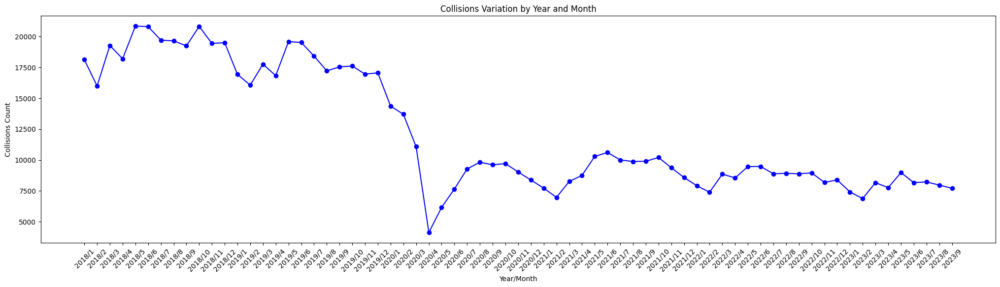

In [212]:
import matplotlib.pyplot as plt

# Convert the 'DATETIME' column to a pandas datetime type
df['DATETIME'] = pd.to_datetime(df['DATETIME'])

# Extract the year and month from the 'DATETIME' column
df['YEAR'] = df['DATETIME'].dt.year
df['MONTH'] = df['DATETIME'].dt.month

# Group the data by year and month and count the number of collisions
grouped_data = df.groupby(['YEAR', 'MONTH']).size().reset_index(name='collisions_count')

# Create a new column combining the year and month for labeling purposes
grouped_data['YEAR_MONTH'] = grouped_data['YEAR'].astype(str) + '/' + grouped_data['MONTH'].astype(str)

# Sort the data by year and month
grouped_data.sort_values(['YEAR', 'MONTH'], inplace=True)

# Increase the size of the plot
plt.figure(figsize=(25, 6))

# Plot the line chart
plt.plot(grouped_data['YEAR_MONTH'], grouped_data['collisions_count'], marker='o', linestyle='-', color='blue')

# Set the title and axis labels
plt.title('Collisions Variation by Year and Month')
plt.xlabel('Year/Month')
plt.ylabel('Collisions Count')

# Rotate the x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.show()

In [213]:
import pandas as pd
import plotly.graph_objects as go
import plotly.subplots as sp

df['DATETIME'] = pd.to_datetime(df['DATETIME'])  # Convert 'DATETIME' column to datetime if not already

# Extract the year and month from the 'DATETIME' column
df['YEAR'] = df['DATETIME'].dt.year
df['MONTH'] = df['DATETIME'].dt.month

# Group the data by year and month and calculate the sum of 'TOTAL_INJURIES' and 'TOTAL_FATALITIES'
injuries_by_year_month = df.groupby(['YEAR', 'MONTH'])[['TOTAL_INJURIES', 'TOTAL_FATALITIES']].sum().reset_index()

# Create subplots with shared x-axis
fig = sp.make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.1)

# Add scatter plot for 'TOTAL_INJURIES'
fig.add_trace(go.Scatter(x=injuries_by_year_month['MONTH'], y=injuries_by_year_month['TOTAL_INJURIES'], mode='markers',
                         name='Total Injuries', marker=dict(color='blue', size=8)), row=1, col=1)

# Add bar chart for 'TOTAL_FATALITIES'
fig.add_trace(go.Bar(x=injuries_by_year_month['MONTH'], y=injuries_by_year_month['TOTAL_FATALITIES'],
                     name='Total Fatalities', marker_color='red'), row=2, col=1)

# Update layout
fig.update_layout(
    title='Total Injuries and Fatalities by Year _ Month',
    xaxis_title='Month',
    height=600,  # Adjust the height of the plot
    showlegend=True,  # Show legend
    legend=dict(x=0.02, y=0.98),  # Adjust the position of the legend
    margin=dict(l=30, r=30, t=80, b=30),  # Adjust the margins
)

# Update y-axis titles
fig.update_yaxes(title_text='Total Injuries', row=1, col=1)
fig.update_yaxes(title_text='Total Fatalities', row=2, col=1)

# Display the plot
fig.show()

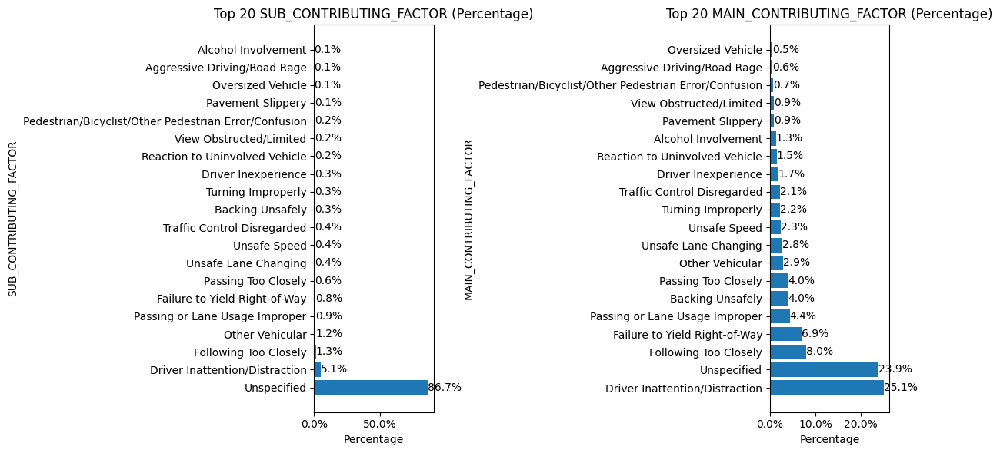

In [214]:
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(12, 6))

# Create the left subplot for SUB_CONTRIBUTING_FACTOR
plt.subplot(121)

# Get the top 20 values of SUB_CONTRIBUTING_FACTOR and calculate percentages
top_20_sub = df['SUB_CONTRIBUTING_FACTOR'].value_counts(normalize=True).nlargest(20) * 100

# Plot the horizontal bar chart for SUB_CONTRIBUTING_FACTOR
bars = plt.barh(top_20_sub.index, top_20_sub.values)

# Set the title and axis labels for SUB_CONTRIBUTING_FACTOR
plt.title('Top 20 SUB_CONTRIBUTING_FACTOR (Percentage)')
plt.xlabel('Percentage')
plt.ylabel('SUB_CONTRIBUTING_FACTOR')

# Format y-axis to display percentages
plt.gca().xaxis.set_major_formatter('{:.1f}%'.format)

# Annotate the bars with the percentage values
for bar in bars:
    width = bar.get_width()
    plt.text(width, bar.get_y() + bar.get_height() / 2, f'{width:.1f}%', ha='left', va='center')

# Create the right subplot for MAIN_CONTRIBUTING_FACTOR
plt.subplot(122)

# Get the top 20 values of MAIN_CONTRIBUTING_FACTOR and calculate percentages
top_20_main = df['MAIN_CONTRIBUTING_FACTOR'].value_counts(normalize=True).nlargest(20) * 100

# Plot the horizontal bar chart for MAIN_CONTRIBUTING_FACTOR
bars = plt.barh(top_20_main.index, top_20_main.values)

# Set the title and axis labels for MAIN_CONTRIBUTING_FACTOR
plt.title('Top 20 MAIN_CONTRIBUTING_FACTOR (Percentage)')
plt.xlabel('Percentage')
plt.ylabel('MAIN_CONTRIBUTING_FACTOR')

# Format y-axis to display percentages
plt.gca().xaxis.set_major_formatter('{:.1f}%'.format)

# Annotate the bars with the percentage values
for bar in bars:
    width = bar.get_width()
    plt.text(width, bar.get_y() + bar.get_height() / 2, f'{width:.1f}%', ha='left', va='center')

# Adjust the spacing to avoid truncation of long labels
plt.tight_layout()

# Show the plot
plt.show()

In [215]:
import pandas as pd
import plotly.graph_objects as go

# Assuming you have a DataFrame named 'df' with columns 'MAIN_CONTRIBUTING_FACTOR', 'TOTAL_INJURIES', and 'TOTAL_FATALITIES'

# Calculate the total injuries and fatalities for each contributing factor
injuries_fatalities_by_factor = df.groupby('MAIN_CONTRIBUTING_FACTOR')[['TOTAL_INJURIES', 'TOTAL_FATALITIES']].sum().reset_index()

# Calculate the percentage of injuries and fatalities for each contributing factor
injuries_fatalities_by_factor['PERCENTAGE_INJURIES'] = injuries_fatalities_by_factor['TOTAL_INJURIES'] / injuries_fatalities_by_factor['TOTAL_INJURIES'].sum() * 100
injuries_fatalities_by_factor['PERCENTAGE_FATALITIES'] = injuries_fatalities_by_factor['TOTAL_FATALITIES'] / injuries_fatalities_by_factor['TOTAL_FATALITIES'].sum() * 100

# Sort the DataFrame by the percentage of fatalities in descending order
injuries_fatalities_by_factor = injuries_fatalities_by_factor.sort_values('PERCENTAGE_FATALITIES', ascending=False)

# Select the top 20 factors
top_20_factors = injuries_fatalities_by_factor.head(20)

# Create the stacked bar chart
fig = go.Figure(data=[
    go.Bar(name='Injuries', x=top_20_factors['MAIN_CONTRIBUTING_FACTOR'], y=top_20_factors['PERCENTAGE_INJURIES']),
    go.Bar(name='Fatalities', x=top_20_factors['MAIN_CONTRIBUTING_FACTOR'], y=top_20_factors['PERCENTAGE_FATALITIES'])
])

# Update layout
fig.update_layout(
    title='Percentage of Injuries and Fatalities by Top 20 Contributing Factors',
    xaxis_title='Contributing Factor',
    yaxis_title='Percentage',
    barmode='stack',
    legend=dict(x=0.02, y=0.98),  # Adjust the position of the legend
    margin=dict(l=30, r=30, t=80, b=30),  # Adjust the margins
    width=1200,  # Adjust the width of the plot
    height=700,  # Adjust the height of the plot
)

# Display the stacked bar chart
fig.show()

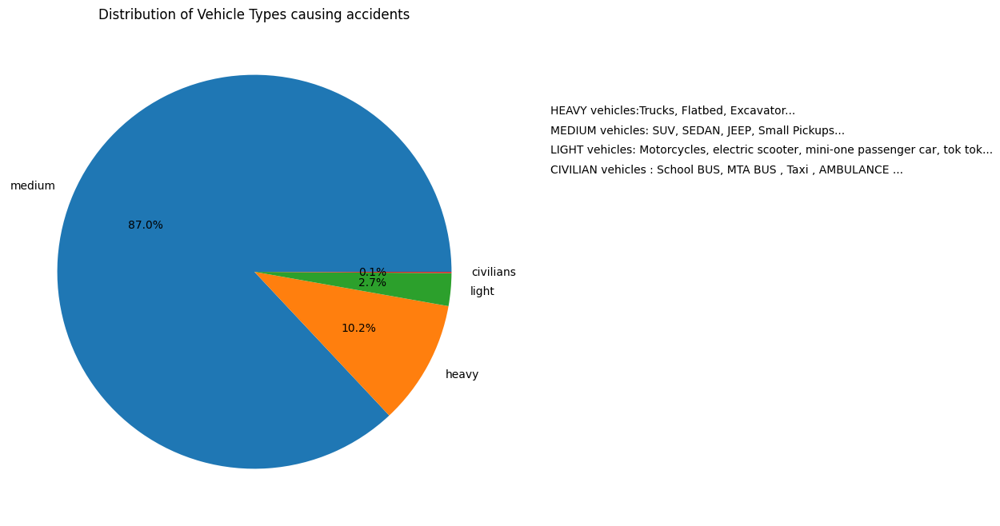

In [216]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 8))
vehicle_types = df['MAIN_VEHICLE_TYPE'].value_counts()
plt.pie(vehicle_types, labels=vehicle_types.index, autopct='%1.1f%%')
plt.title('Distribution of Vehicle Types causing accidents')

# Define the text labels and their corresponding positions
labels = [ 'HEAVY vehicles:Trucks, Flatbed, Excavator...',
          'MEDIUM vehicles: SUV, SEDAN, JEEP, Small Pickups...',
          'LIGHT vehicles: Motorcycles, electric scooter, mini-one passenger car, tok tok...',
          'CIVILIAN vehicles : School BUS, MTA BUS , Taxi , AMBULANCE ...',
         ]
positions = [(1.5, 0.8), (1.5, 0.7), (1.5, 0.6),(1.5,0.5)]

# Add the text labels
for label, pos in zip(labels, positions):
    plt.text(*pos, label, ha='left')

plt.show()

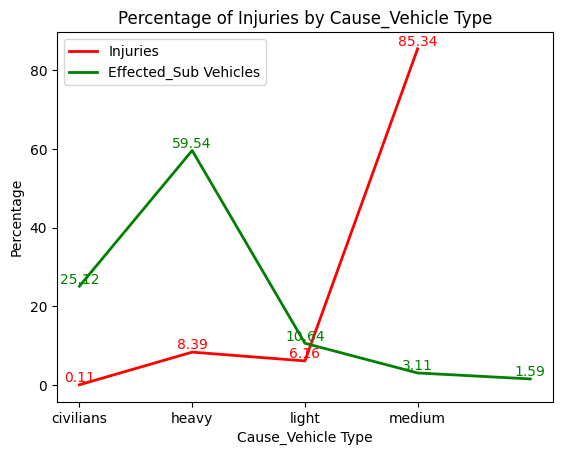

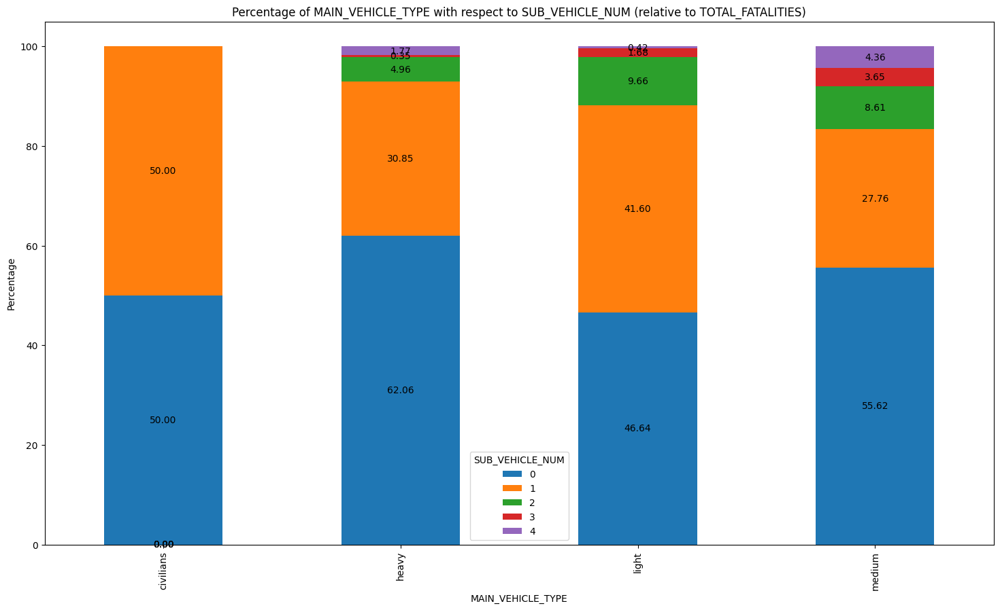

In [217]:
import matplotlib.pyplot as plt

# Group the data by MAIN_VEHICLE_TYPE and calculate the sum of TOTAL_INJURIES
grouped_data_injuries = df.groupby('MAIN_VEHICLE_TYPE')['TOTAL_INJURIES'].sum().reset_index(name='total_injuries')

# Calculate the percentage relative to the total injuries for each MAIN_VEHICLE_TYPE
grouped_data_injuries['percentage'] = (grouped_data_injuries['total_injuries'] / grouped_data_injuries['total_injuries'].sum()) * 100

# Add a line representing the percentage of total injuries
plt.plot(grouped_data_injuries['MAIN_VEHICLE_TYPE'], grouped_data_injuries['percentage'], color='red', linewidth=2)

# Continue with the remaining code to plot the stacked bar chart
grouped_data_inj_type = df.groupby('SUB_VEHICLE_NUM')['TOTAL_INJURIES'].sum().reset_index(name='total_injuries')
grouped_data_inj_type['percentage'] = (grouped_data_inj_type['total_injuries'] / grouped_data_inj_type['total_injuries'].sum()) * 100
plt.plot(grouped_data_inj_type['SUB_VEHICLE_NUM'], grouped_data_inj_type['percentage'], color='green', linewidth=2)

# Add labels to the lines
for x, y in zip(grouped_data_injuries['MAIN_VEHICLE_TYPE'], grouped_data_injuries['percentage']):
    plt.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='red')

for x, y in zip(grouped_data_inj_type['SUB_VEHICLE_NUM'], grouped_data_inj_type['percentage']):
    plt.text(x, y, f'{y:.2f}', ha='center', va='bottom', color='green')

# Add a legend
plt.legend(['Injuries', 'Effected_Sub Vehicles'])

# Set the title and axis labels
plt.title('Percentage of Injuries by Cause_Vehicle Type')
plt.xlabel('Cause_Vehicle Type')
plt.ylabel('Percentage')

#####
#import matplotlib.pyplot as plt

# Group the data by MAIN_VEHICLE_TYPE, SUB_VEHICLE_NUM, and calculate the sum of TOTAL_FATALITIES
grouped_data_fatalities = df.groupby(['SUB_VEHICLE_NUM', 'MAIN_VEHICLE_TYPE'])['TOTAL_FATALITIES'].sum().reset_index(name='total_fatalities')

# Calculate the percentage relative to the total fatalities for each MAIN_VEHICLE_TYPE
grouped_data_fatalities['percentage'] = grouped_data_fatalities.groupby('MAIN_VEHICLE_TYPE', group_keys=False)['total_fatalities'].apply(lambda x: (x / x.sum()) * 100)

# Pivot the data for plotting
pivot_data = grouped_data_fatalities.pivot(index='MAIN_VEHICLE_TYPE', columns='SUB_VEHICLE_NUM', values='percentage')

# Plot the bar chart
ax = pivot_data.plot(kind='bar', stacked=True, figsize=(18,10))

# Set the title and axis labels
plt.title('Percentage of MAIN_VEHICLE_TYPE with respect to SUB_VEHICLE_NUM (relative to TOTAL_FATALITIES)')
plt.xlabel('MAIN_VEHICLE_TYPE')
plt.ylabel('Percentage')

# Add a legend
plt.legend(title='SUB_VEHICLE_NUM')

# Add labels to the stacked bars
for container in ax.containers:
    for rect in container:
        width = rect.get_width()
        height = rect.get_height()
        x = rect.get_x()
        y = rect.get_y()

        # Display the value on top of each bar
        plt.text(x + width / 2, y + height / 2, f'{height:.2f}', ha='center', va='center')

# Show the plot
plt.show()

In [218]:
import pandas as pd
import plotly.express as px
import reverse_geocoder as rg
from sklearn.preprocessing import MinMaxScaler

# Assuming you have a DataFrame named 'df' with columns 'LATITUDE', 'LONGITUDE', 'TOTAL_INJURIES', and 'SUB_VEHICLES_NUM'
# Calculate the new column 'DANGER_RATE' as the sum of CASULTIES
df['DANGER_RATE'] = df['TOTAL_INJURIES'] + 2 * df['TOTAL_FATALITIES'] + df['PEDESTRIANS_INJURIES'] + df['PEDESTRIANS_FATALITIES'] + 0.5 * df['SUB_VEHICLE_NUM']
# Normalize the 'DANGER_LOC' values to a range of 1 to 100
scaler = MinMaxScaler(feature_range=(1, 100))
df['DANGER_RATE'] = scaler.fit_transform(df[['DANGER_RATE']])

# Sort the DataFrame by 'DANGER_LOC' in descending order and select the top 100 locations
top_1000_locations = df.nlargest(1000, 'DANGER_RATE')

# Reverse geocode the latitude and longitude coordinates to obtain location names
coordinates = list(zip(top_1000_locations['LATITUDE'], top_1000_locations['LONGITUDE']))
results = rg.search(coordinates)  # Perform reverse geocoding

# Extract location names from the reverse geocode results
locations = [result['name'] for result in results]

# Add the location names as a new column in the DataFrame
top_1000_locations['LOCATION'] = locations


# Create the scatter plot
fig = px.scatter_mapbox(
    top_1000_locations,
    lat='LATITUDE',
    lon='LONGITUDE',
    hover_name='LOCATION',
    size='SUB_VEHICLE_NUM',
    color='DANGER_RATE',
    color_continuous_scale='Viridis',
    size_max=10,
    zoom=1
)

# Update the mapbox style
fig.update_layout(mapbox_style='carto-positron')

# Update the layout of the plot
fig.update_layout(
    title='Top 1000 danger Locations in nyc ',
    margin=dict(l=0, r=0, t=40, b=0)
)

# Show the scatter plot
fig.show()

#MODULE TEST,TRAIN

In [219]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 841660 entries, 0 to 2030509
Data columns (total 15 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   LATITUDE                  841660 non-null  float64       
 1   LONGITUDE                 841660 non-null  float64       
 2   TOTAL_INJURIES            841660 non-null  int64         
 3   TOTAL_FATALITIES          841660 non-null  int64         
 4   PEDESTRIANS_INJURIES      841660 non-null  int64         
 5   PEDESTRIANS_FATALITIES    841660 non-null  int64         
 6   MAIN_CONTRIBUTING_FACTOR  841660 non-null  object        
 7   COLLISION_ID              841660 non-null  int64         
 8   DATETIME                  841660 non-null  datetime64[ns]
 9   SUB_VEHICLE_NUM           841660 non-null  int64         
 10  SUB_CONTRIBUTING_FACTOR   841660 non-null  object        
 11  MAIN_VEHICLE_TYPE         841660 non-null  object        
 12  Y

In [220]:
# Extract day and hour from DATETIME column
df['DAY'] = df['DATETIME'].dt.day
df['HOUR'] = df['DATETIME'].dt.hour


In [221]:
df1 = df = df.drop(['SUB_CONTRIBUTING_FACTOR','PEDESTRIANS_INJURIES','PEDESTRIANS_FATALITIES','DATETIME'] , axis =1 )

In [228]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 841660 entries, 0 to 2030509
Data columns (total 13 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   LATITUDE                  841660 non-null  float64
 1   LONGITUDE                 841660 non-null  float64
 2   TOTAL_INJURIES            841660 non-null  int64  
 3   TOTAL_FATALITIES          841660 non-null  int64  
 4   MAIN_CONTRIBUTING_FACTOR  841660 non-null  object 
 5   COLLISION_ID              841660 non-null  int64  
 6   SUB_VEHICLE_NUM           841660 non-null  int64  
 7   MAIN_VEHICLE_TYPE         841660 non-null  object 
 8   YEAR                      841660 non-null  int64  
 9   MONTH                     841660 non-null  int64  
 10  DANGER_RATE               841660 non-null  float64
 11  DAY                       841660 non-null  int64  
 12  HOUR                      841660 non-null  int64  
dtypes: float64(3), int64(8), object(2)
memory u

    LATITUDE  LONGITUDE  TOTAL_INJURIES  TOTAL_FATALITIES  COLLISION_ID  \
0  40.667202 -73.866500               2                 0       4455765   
1  40.667202 -73.866500               1                 0       4513547   
2  40.667202 -73.866500               0                 0       4541903   
3  40.667202 -73.866500               0                 0       4456314   
4  40.683304 -73.917274               0                 0       4486609   

   SUB_VEHICLE_NUM  YEAR  MONTH  DANGER_RATE  DAY  ...  \
0                1  2021      9       7.1875   11  ...   
1                0  2022      3       3.4750   26  ...   
2                1  2022      6       2.2375   29  ...   
3                0  2021      9       1.0000   11  ...   
4                0  2021     12       1.0000   14  ...   

   MAIN_CONTRIBUTING_FACTOR_Unsafe Speed  \
0                                      0   
1                                      0   
2                                      0   
3                       

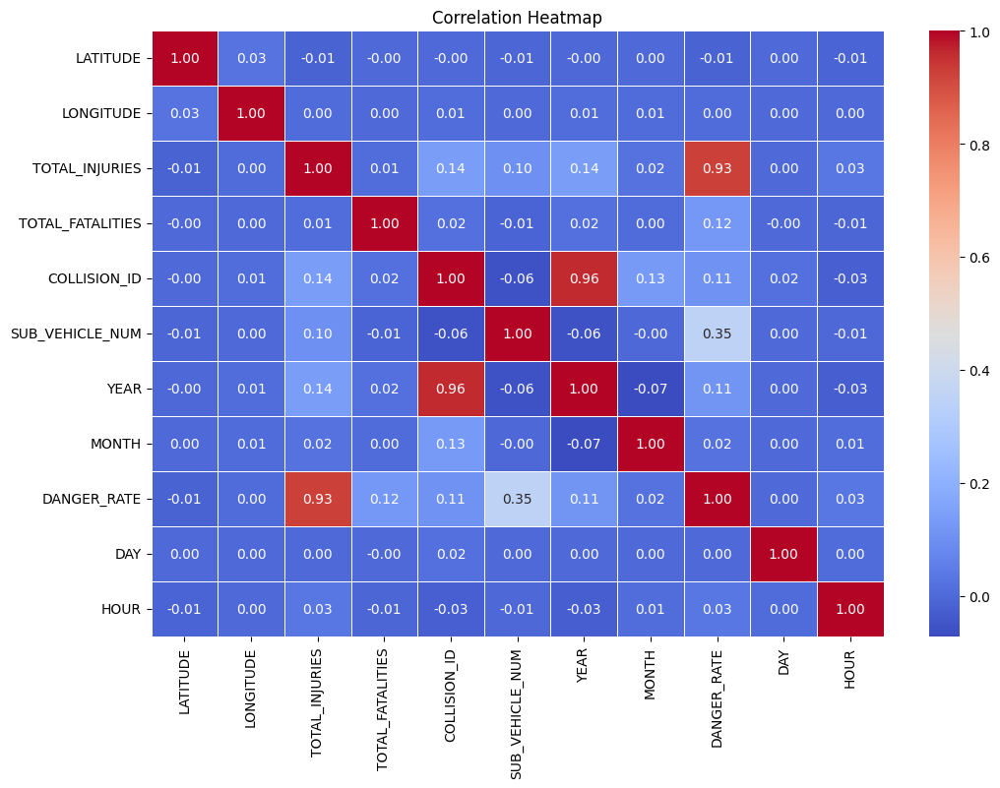

<ipython-input-244-229cfe9674be>:34: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Mean Squared Error: 0.32800423560824143
R-squared: 0.9344016513500131


In [244]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

# Categorical columns for one-hot encoding
categorical_columns = ['MAIN_CONTRIBUTING_FACTOR', 'MAIN_VEHICLE_TYPE']

# Perform one-hot encoding
one_hot_encoded = pd.get_dummies(df, columns=categorical_columns)

# Display the one-hot encoded dataset
print(one_hot_encoded.head())

# Numerical columns for correlation heatmap
numerical_columns = df.select_dtypes(include=['float64', 'int64'])

# Calculate correlation matrix
correlation_matrix = numerical_columns.corr()

# Plot correlation heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

# Target and predictor variables for modeling
target_variable = 'DANGER_RATE'
predictor_variables = [ 'TOTAL_INJURIES','TOTAL_FATALITIES','SUB_VEHICLE_NUM','YEAR','MONTH','DAY','HOUR']

# Create a subset of data for modeling
data_subset = df[[target_variable] + predictor_variables]
data_subset.dropna(inplace=True)

# Split data into training and testing sets
X = data_subset[predictor_variables]
y = data_subset[target_variable]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42 )

# Create and train the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("R-squared:", r2)